## SpaGFT Tutorial: Codex A6

### Outline
1. Import packages
<br />
<br />
2. Load data
<br />
<br />
3. QC
<br />
<br />
4. Function: identify spatially variable proteins
<br />
<br />
6. Function: characterize functional tissue units 

In this case, we will show the applications of SpaGFT on spatial proteomics. The installation steps can be found [here](https://github.com/jxLiu-bio/SpaGFT). SpaGFT is a python package to analyze spatial transcriptomics data via graph Fourier transform. To install SpaGFT, the python version is required to be >= 3.7. You can check your python version by:

In [1]:
import platform
platform.python_version()

'3.8.18'

### 1. Import packages

In [2]:
import SpaGFT as spg
import numpy as np
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
import os


sc.logging.print_header()
sc.settings.set_figure_params(dpi=80, facecolor='white')

scanpy==1.9.1 anndata==0.9.2 umap==0.5.5 numpy==1.21.5 scipy==1.8.0 pandas==1.4.2 scikit-learn==1.0.2 statsmodels==0.14.1 python-igraph==0.9.10 louvain==0.7.1 pynndescent==0.5.11


Define the folder to save the results which are generated from the following analysis:

In [3]:
results_folder = './results/codex_lymphnode_A6/'
if not os.path.exists(results_folder):
    os.makedirs(results_folder)

### 2. Load data

In this tutorial, we use a human lymph node codex dataset. The dataset can be downloaded [here](https://drive.google.com/drive/folders/1-B9ipgx5gdWU-go38-acCdS9xHCK9D3E?usp=sharing). The A6 region is selected for the following analysis. The original dataset is compressed to 200 * 200 spots. Two key elements are essential for running SpaGFT, including the count matrix and spatial coordinates of spots. Note that the basic object inputting to SpaGFT should be an anndata object which contains the above two elements.

In [4]:
# Load data
adata = sc.read_h5ad("./data/A6_compress_codex.h5ad")
adata.var_names_make_unique()
# Add raw to anndata object
adata.raw = adata
adata

AnnData object with n_obs × n_vars = 40000 × 53
    obs: 'x', 'y'

You can also create your datasets which are ```anndata``` objects. Note that the raw count matrix should be found in adata.X, and the spatial coordinates of all spots should be found in ```adata.obs``` or ```adata.obsm```. You can use diverse functions provided by scanpy to create the anndata object. For example, you can read Visium datasets by
```Python
sc.read_visium() # recommend
```
Alternatively, users can also create the anndata object using the raw count matrix and spatial coordinates of spots in a direct way:
```Python
count_mtx = pd.read_csv(PATH_TO_COUNT_MATRIX)
coord_mtx = pd.read_csv(PATH_TO_COORDINATE_MATRIX)
count_mtx.iloc[:5, :5]
coord_mtx.iloc[:5, :5]
# create the anndata object
adata = sc.AnnData(count_mtx)
adata.obs.loc[:, ['x', 'y']] = coord_mtx
adata.var_names_make_unique()
adata.raw = adata
```
More approaches to load datasets can be found at [Scanpy](https://scanpy.readthedocs.io/en/stable/api.html#reading)


### 3. QC
We perform some basic filtering of proteins

In [5]:
# QC
sc.pp.filter_genes(adata, min_cells=10)

### 4. Function: identify spatially variable genes

#### 4.1 Determine the Fourier modes and identify SVGs

Spatially variable proteins (SVPs) are proteins that exhibit specific spatial patterns. SpaGFT will transform protein signals from the spatial/vertex domain to the frequency/spectral domain and identify SVPs in the frequency domain. 

To begin with, SpaGFT provides the dermine_frequency_ratio function based on the kneedle algorithm to determine how many FMs used automatically.
Note that *ratio_low * $\sqrt{n}$* and *ratio_high * $\sqrt{n}$* are the recommended low-frequency and high-frequency FMs, where *$\sqrt{n}$* is the number of spots in the original dataset.

In [6]:
# determine the number of low-frequency FMs and high-frequency FMs
(ratio_low, ratio_high) = spg.gft.determine_frequency_ratio(adata,
                                                            ratio_neighbors=1,
                                                            spatial_info=['x', 'y'])

Obatain the Laplacian matrix


In [7]:
# calculation
protein_df = spg.detect_svg(adata,
                            spatial_info=['x', 'y'],
                            ratio_low_freq=ratio_low,
                            ratio_high_freq=ratio_high,
                            ratio_neighbors=1,
                            filter_peaks=True,
                            S=6)
# extract spaitally variable proteins
# for non-whole-transcriptomics datasets, use qvalue as cutoff to obtain spatial variable features
svp_list = protein_df[protein_df.fdr < 0.05].index.tolist()
print("The number of SVPs: ", len(svp_list))
# the top 10 SVPs
print(svp_list[:10])

The precalculated low-frequency FMs are USED
The precalculated high-frequency FMs are USED
Graph Fourier Transform finished!
svg ranking could be found in adata.var['svg_rank']
The spatially variable genes judged by gft_score could be found 
          in adata.var['cutoff_gft_score']
Gene signals in frequency domain when detect svgs could be found
          in adata.varm['freq_domain_svg']
The number of SVPs:  53
['reg001_cyc010_ch003_CD20', 'reg001_cyc025_ch003_CD45', 'reg001_cyc023_ch004_Podoplanin', 'reg001_cyc017_ch003_HLA-DR', 'reg001_cyc013_ch004_CD45RA', 'reg001_cyc019_ch004_CD11b', 'reg001_cyc004_ch003_TCR-g-d', 'reg001_cyc008_ch003_CD5', 'reg001_cyc004_ch004_CCR6', 'reg001_cyc018_ch003_BCL-2']


#### 4.2 Visualize the identified SVPs

We will visualize several detected genes which exhibit diverse spatial patterns. This step can be achieved by ```sc.pl.spatial``` function provided by scanpy or our built-in ```scatter_gene``` function to visualize gene expression patterns.

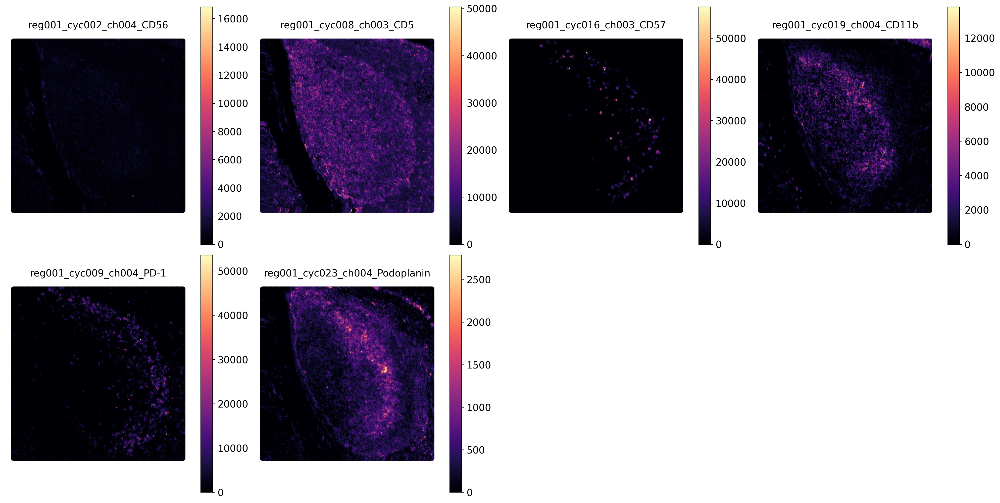

In [8]:
plot_svps = ["reg001_cyc002_ch004_CD56",
             "reg001_cyc008_ch003_CD5",
             "reg001_cyc016_ch003_CD57",
             "reg001_cyc019_ch004_CD11b",
             "reg001_cyc009_ch004_PD-1",
             "reg001_cyc023_ch004_Podoplanin"]
spg.plot.scatter_gene(adata, gene=plot_svps, 
                      spatial_info=['x', 'y'], cmap='magma')

#### 4.3 Plot frequency signals

One of the characteristics of SpaGFT is that it can obtain new representations for features in the frequency domain. In above proteins' frequency signals can be found in ```adata.varm['freq_domain_svg']``` and visualized by

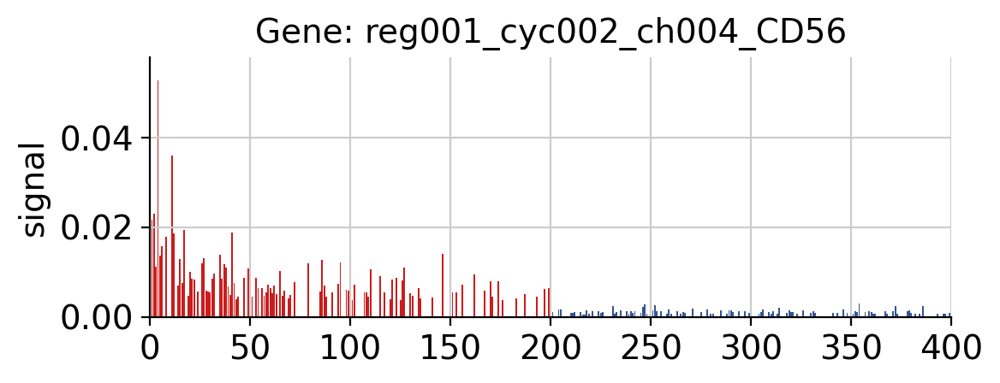

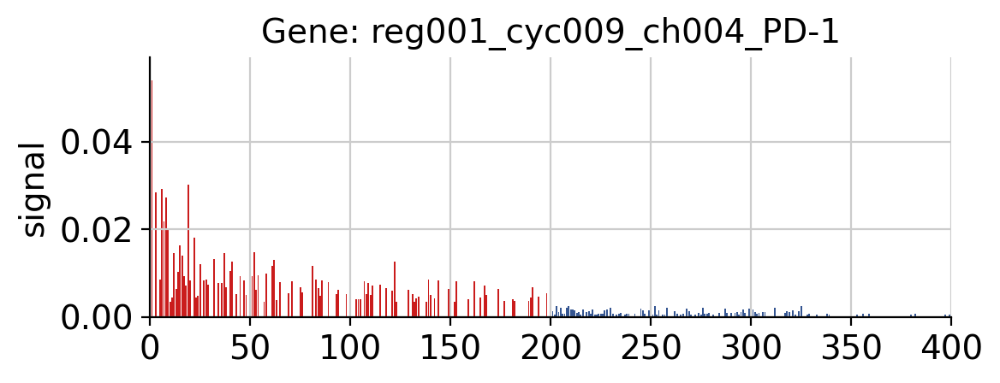

In [9]:
spg.plot.gene_freq_signal(adata, gene=plot_svps[0])
spg.plot.gene_freq_signal(adata, gene=plot_svps[4])

### 5. Function: identify functional tissue units 

#### 5.1 Group SVGs based on frequency signals

The core of SpaGFT is that it can utilize SVPs to characterize functional  by the groups of SVPs with coincident spatial patterns. To achieve this, SpaGFT will analyze and process the low-frequency parts of the signal. In SpaGFT, the Louvain algorithm is used to cluster frequency signals of proteins, whose parameter ```resolution``` will be selected based on the designed objective function. Users can input the resolution range by giving ```(start, end, step)```.

In [10]:
# functional tissue units (FTUs)
protein_df, adata = spg.identify_ftu(adata, 
                                    svg_list=svp_list,
                                    ratio_fms=ratio_low,
                                    spatial_info=['x', 'y'],
                                    resolution=(1.5, 2, 0.1),
                                    ratio_neighbors=1,
                                    n_neighbors=5)

         Falling back to preprocessing with `sc.pp.pca` and default params.
resolution: 1.500;  score: 0.0429
resolution: 1.600;  score: 0.0429
resolution: 1.700;  score: 0.0429
resolution: 1.800;  score: 0.0554
resolution: 1.900;  score: 0.1071


The above step will identify proteins groups based on their spatial patterns. and the results can be found at adata.var['functional_tissue_unit']. The genes in a group support a common spatial pattern, which is called a functional tissue unit. Besides, the functional tissue unit information can be found at adata.obsm['ftu_binary'].

In [11]:
# the genes which support corresponding functional tissue units
protein_df.to_csv(os.path.join(results_folder,
                           'Codex_A6_protein_information_results.csv'))
protein_df.iloc[:5, :]

,n_cells,gft_score,svg_rank,cutoff_gft_score,pvalue,fdr,ftu
reg001_cyc010_ch003_CD20,36841,11.052103,1,True,5.248498e-100,1.267598e-98,1
reg001_cyc025_ch003_CD45,38870,9.635407,2,True,8.484761e-99,8.538368e-98,1
reg001_cyc023_ch004_Podoplanin,31300,9.398110,3,True,5.248498e-100,1.267598e-98,2
reg001_cyc017_ch003_HLA-DR,38074,8.781366,4,True,3.789006e-99,4.159577e-98,1
reg001_cyc013_ch004_CD45RA,36548,8.577937,5,True,3.241618e-98,2.699668e-97,1


#### 5.2 Visualize clustering results

We visualize the clustering results by UMAP by:

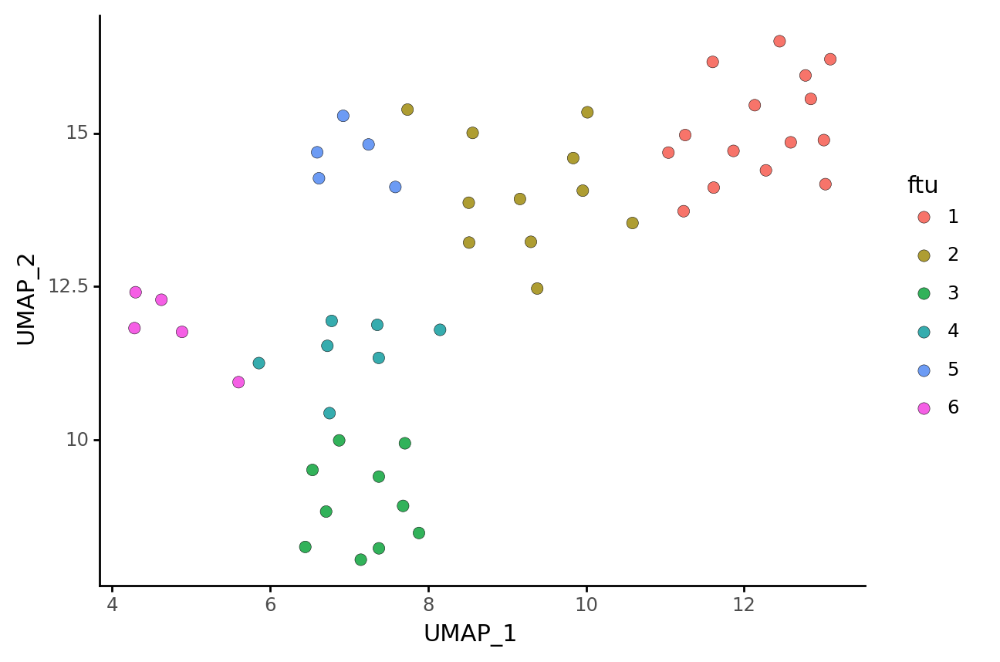

In [12]:
spg.plot.scatter_umap_clustering(adata, svp_list)

#### 5.3 Extract functional tissue units information

There are six functional tissues unit via our computation. In the following, we will visualization the results. To begin with, obtain functional tissue units information:

In [13]:
# The functional tissue units information can be obtained by
ftu_binary_df = adata.obsm['ftu_binary']
ftu_binary_df.to_csv(os.path.join(results_folder,
                           'Codex_A6_functional_tissue_units_information_results.csv'))
ftu_binary_df.iloc[:5, :]

,ftu_1,ftu_2,ftu_3,ftu_4,ftu_5,ftu_6
1_200,1,0,1,0,0,1
2_200,0,0,1,1,0,1
3_200,0,0,1,0,0,1
4_200,0,0,1,0,0,1
5_200,0,0,1,1,0,1


#### 5.4 Visualize interested FTUs

We can visualize the interested functional tissue units by built-in scatter_ftu function:

Specifically, we can also visualize functional tissue units and proteins that support corresponding functional tissue units:

In [14]:
ftu2_svps = ["reg001_cyc019_ch004_CD11b",
            "reg001_cyc011_ch003_CD11c",
            "reg001_cyc023_ch004_Podoplanin"]
spg.plot.scatter_ftu_gene(adata,
                         ftu="ftu_2",
                         ftu_color='#9aabe1',
                         gene=ftu2_svps,
                         spatial_info=['x', 'y'])